In [1]:
!python.exe -m pip install --upgrade pip
%pip install -r requirements.txt > output.txt
import pygris, shapely, itables
import geopandas as gpd
import contextily as cx
import h3pandas
from matplotlib import pyplot as plt

Note: you may need to restart the kernel to use updated packages.


In [2]:
usa = pygris.states(cache=True)

Using the default year of 2021


In [3]:
usa

,STATEFP,STATENS,AFFGEOID,GEOID,STUSPS,NAME,LSAD,ALAND,AWATER,geometry
0,56,01779807,0400000US56,56,WY,Wyoming,00,251458712294,1867503716,"POLYGON ((-111.05456 45.00095, -111.04507 45.0..."
1,02,01785533,0400000US02,02,AK,Alaska,00,1478942847588,245378425142,"MULTIPOLYGON (((179.48246 51.98283, 179.48657 ..."
2,24,01714934,0400000US24,24,MD,Maryland,00,25151992308,6979074857,"MULTIPOLYGON (((-76.05015 37.98691, -76.04998 ..."
3,60,01802701,0400000US60,60,AS,American Samoa,00,197759069,1307243751,"MULTIPOLYGON (((-168.14582 -14.54791, -168.145..."
4,05,00068085,0400000US05,05,AR,Arkansas,00,134660767709,3121950081,"POLYGON ((-94.61792 36.49941, -94.61765 36.499..."
5,38,01779797,0400000US38,38,ND,North Dakota,00,178694310772,4414779956,"POLYGON ((-104.04868 48.86378, -104.04865 48.8..."
6,10,01779781,0400000US10,10,DE,Delaware,00,5046731559,1399179670,"MULTIPOLYGON (((-75.56555 39.51485, -75.56174 ..."
7,66,01802705,0400000US66,66,GU,Guam,00,543555847,934337453,"MULTIPOLYGON (((144.64538 13.23627, 144.64764 ..."
8,35,00897535,0400000US35,35,NM,New Mexico,00,314198560947,726482113,"POLYGON ((-109.05017 31.48000, -109.04984 31.4..."
9,49,01455989,0400000US49,49,UT,Utah,00,213355072799,6529973239,"POLYGON ((-114.05296 37.59278, -114.05247 37.6..."


In [4]:
wa = usa[usa.STUSPS == 'WA'].reset_index(drop=True)

In [5]:
wa.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

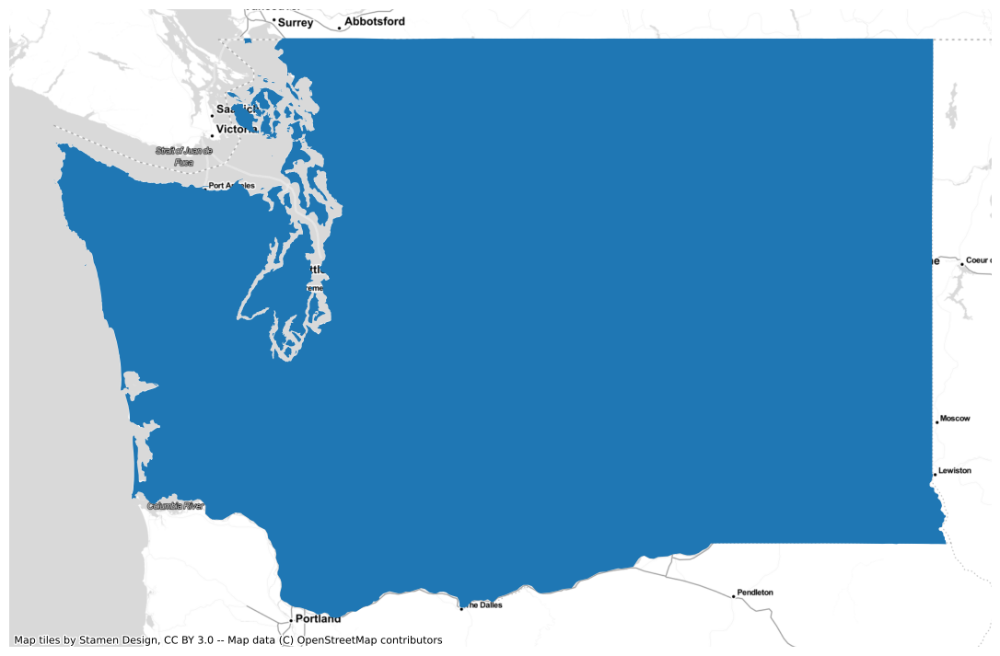

In [75]:
projection = 3857
ax = wa.to_crs(epsg=projection).plot(figsize=(15,9))
ax.axis('off')
cx.add_basemap(ax, crs=projection, source=cx.providers.Stamen.TonerLite)

In [7]:
whitman = pygris.counties(state='WA', cache=True)

Using the default year of 2021
Using FIPS code '53' for input 'WA'


In [8]:
wa_blocks = pygris.blocks(state='WA', cache=True)

Using the default year of 2021
Using FIPS code '53' for input 'WA'


In [9]:
wa_blocks.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

<Axes: >

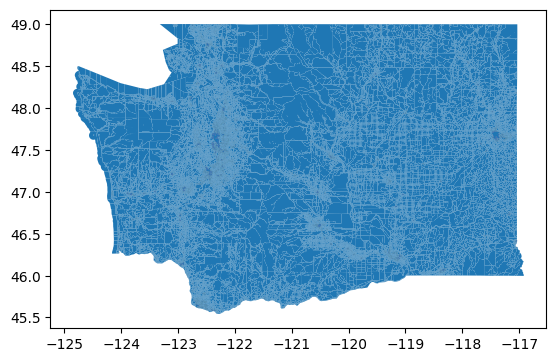

In [10]:
wa_blocks.plot()

In [11]:
whitmanBlocks = wa_blocks[wa_blocks.COUNTYFP20=='075']

In [12]:
wa_h3 = gpd.read_file('Washington_hex8s.gpkg')

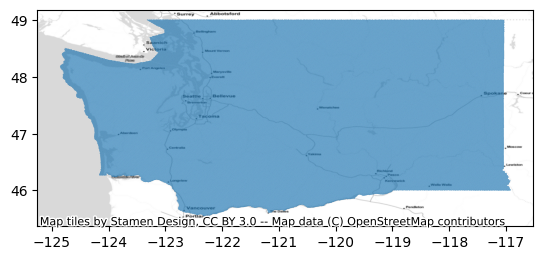

In [13]:
ax = wa_h3.plot()
# ax.set_xlim=(-118,-116.5)
# ax.set_ylim=(46,47)
cx.add_basemap(ax, crs=wa_h3.crs.to_string(), source=cx.providers.Stamen.TonerLite)


In [14]:
wa.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

In [15]:
whitman = whitman[whitman.NAME == "Whitman"]

In [16]:
whitmanH3 = whitman.h3.polyfill(8, explode=True)

<Axes: >

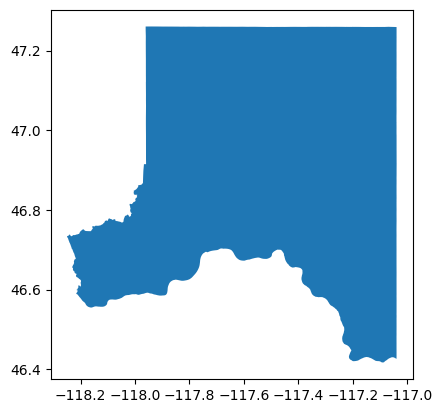

In [17]:
whitman.plot()

In [18]:
whitmanH3 = whitmanH3.set_index('h3_polyfill')
# .h3.h3_to_geo_boundary()

In [19]:
whitmanH3 = whitmanH3.to_crs(epsg=4326).h3.h3_to_geo_boundary()

<Axes: >

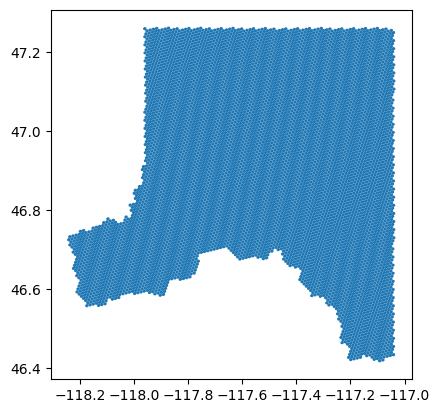

In [20]:
whitmanH3.plot()

<Axes: >

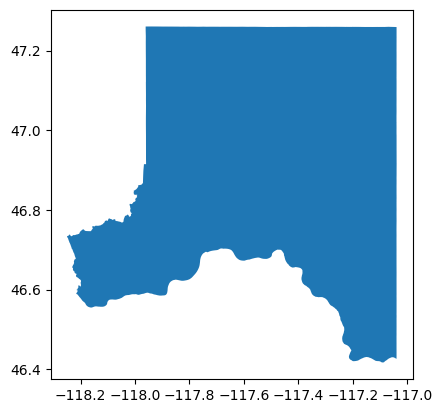

In [21]:
whitman.plot()

<Axes: >

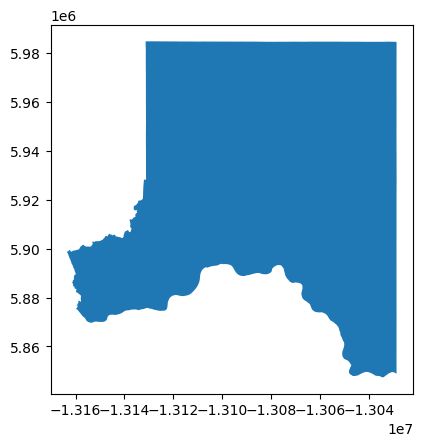

In [22]:
whitman.to_crs(epsg=3857).plot()

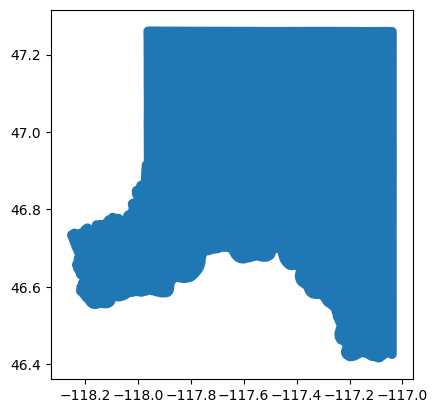

In [50]:
whitmanBuffer = whitman.to_crs(epsg=3857)
whitmanBuffer = whitmanBuffer.buffer(2000)
whitmanBuffer = gpd.GeoDataFrame(whitmanBuffer)
whitmanBuffer = whitmanBuffer.rename(columns={0: 'geometry'})
whitmanBuffer = whitmanBuffer.set_geometry('geometry')
whitmanBuffer = whitmanBuffer.to_crs(epsg=4326)
ax = whitmanBuffer.plot()

In [51]:
whitmanBufferH3 = whitmanBuffer.h3.polyfill(8, explode=True)
whitmanBufferH3 = whitmanBufferH3.set_index('h3_polyfill')
whitmanBufferH3 = whitmanBufferH3.to_crs(epsg=4326).h3.h3_to_geo_boundary()

In [52]:
whitman.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

In [53]:
whitmanBufferH3.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 9000 entries, 88288aa1bdfffff to 88288aa043fffff
Data columns (total 1 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   geometry  9000 non-null   geometry
dtypes: geometry(1)
memory usage: 398.7+ KB


In [54]:
whitman_blocks = wa_blocks[wa_blocks.COUNTYFP20 == '075']

<Axes: >

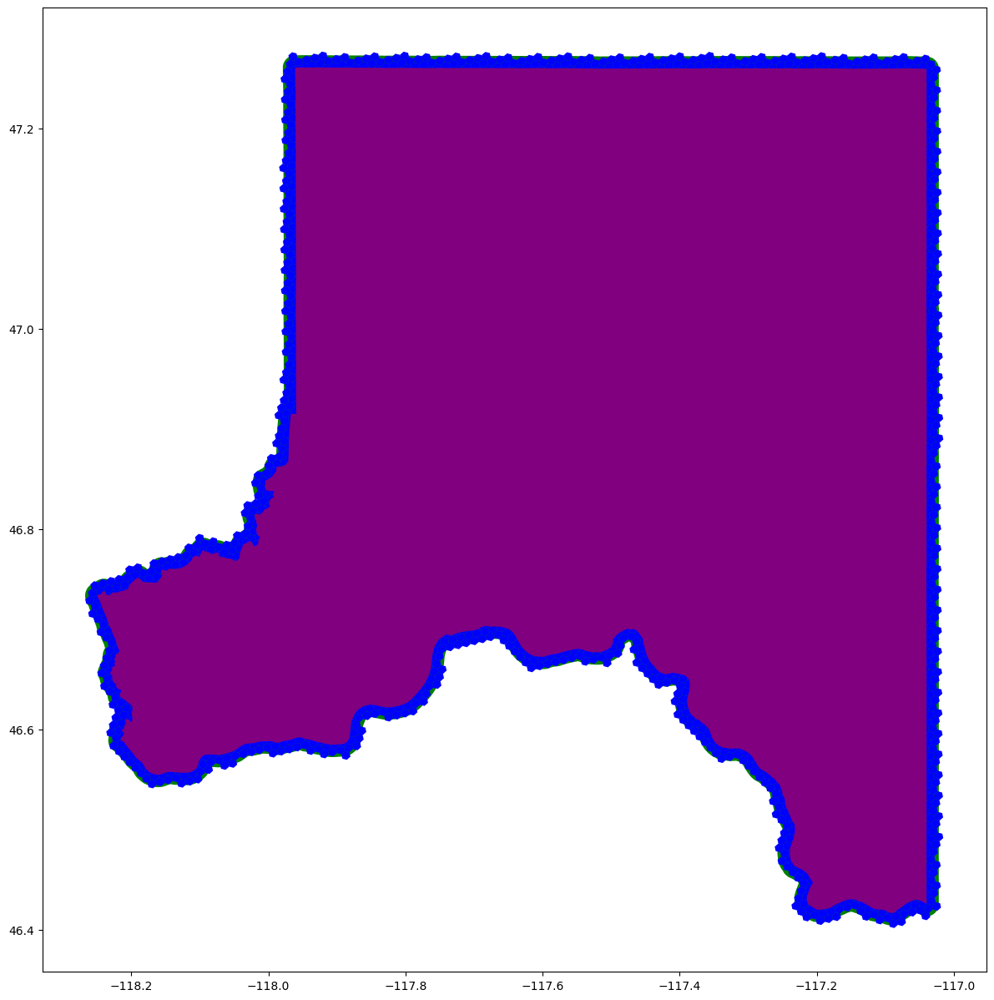

In [55]:
fig, ax = plt.subplots(figsize=(15,15))
whitmanBuffer.plot(ax=ax, color='green')
whitmanBufferH3.plot(ax=ax, color='blue')
# whitmanH3.plot(ax=ax, color='yellow')
whitman.plot(ax=ax, color='purple')
# whitman_blocks.plot(ax=ax, color='red')


In [56]:
whitman

,STATEFP,COUNTYFP,COUNTYNS,GEOID,NAME,NAMELSAD,LSAD,CLASSFP,MTFCC,CSAFP,CBSAFP,METDIVFP,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
2903,53,075,01533501,53075,Whitman,Whitman County,06,H1,G4020,446,39420,NaN,A,5592463291,48246698,+46.9059441,-117.5353898,"POLYGON ((-117.17214 47.25955, -117.17203 47.2..."


In [57]:
itables.show(whitmanBlocks)

In [58]:
whitmanBufferH3 = whitmanBufferH3.reset_index()

In [59]:
whitmanBufferH3 = whitmanBufferH3.to_crs(epsg=4269)

<Axes: >

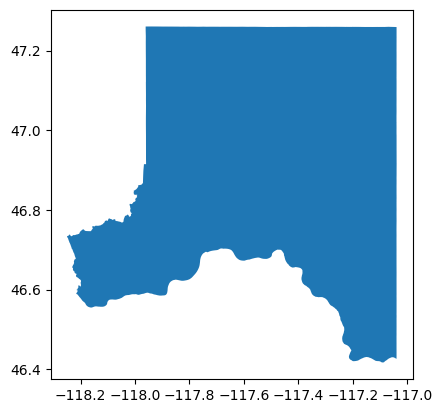

In [60]:
whitman.plot()

In [61]:
whitmanClippedH3 = whitmanBufferH3.clip(mask=whitman.to_crs(epsg=4326))

c:\Users\nick.pappin\projects\FreeFabric\.venv\Lib\site-packages\geopandas\geodataframe.py:2361: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:4269
Right CRS: EPSG:4326

  return geopandas.clip(self, mask=mask, keep_geom_type=keep_geom_type)


In [62]:
itables.show(whitmanBufferH3)

In [63]:
# whitmanHexBlock = shapely.union_all([whitmanBlocks.geometry.to_list(), whitmanBufferH3])
whitmanHexBlock = gpd.overlay(whitmanBlocks, whitmanClippedH3, how='union')

C:\Users\nick.pappin\AppData\Local\Temp\ipykernel_4396\2229153138.py:2: UserWarning: `keep_geom_type=True` in overlay resulted in 103 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  whitmanHexBlock = gpd.overlay(whitmanBlocks, whitmanClippedH3, how='union')


In [64]:
itables.show(whitmanHexBlock)

In [65]:
whitmanHexBlock.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 21535 entries, 0 to 21534
Data columns (total 17 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   STATEFP20    20441 non-null  object  
 1   COUNTYFP20   20441 non-null  object  
 2   TRACTCE20    20441 non-null  object  
 3   BLOCKCE20    20441 non-null  object  
 4   GEOID20      20441 non-null  object  
 5   NAME20       20441 non-null  object  
 6   MTFCC20      20441 non-null  object  
 7   UR20         20441 non-null  object  
 8   UACE20       0 non-null      float64 
 9   UATYPE20     0 non-null      float64 
 10  FUNCSTAT20   20441 non-null  object  
 11  ALAND20      20441 non-null  float64 
 12  AWATER20     20441 non-null  float64 
 13  INTPTLAT20   20441 non-null  object  
 14  INTPTLON20   20441 non-null  object  
 15  h3_polyfill  20716 non-null  object  
 16  geometry     21535 non-null  geometry
dtypes: float64(4), geometry(1), object(12)
memory usage: 2.8+ MB


In [66]:
whitmanHexBlock['hexBlock'] = whitmanHexBlock.h3_polyfill.astype('str') + '+' + whitmanHexBlock.GEOID20.astype('str')

In [67]:
itables.show(whitmanHexBlock)

In [68]:
whitmanHexBlock.explore()

In [69]:
whitman.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

In [70]:
whitman = whitman.set_crs(whitman.crs, allow_override=True)

In [71]:
wa_poly = wa.iloc[0].geometry

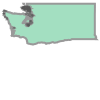

In [72]:
wa_poly

In [73]:
wa_poly = shapely.to_geojson(wa_poly)
polys = list()
polys.append(wa_poly)

In [74]:
type(wa_poly)

str